In [ ]:
# required dependencies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import datetime as dt
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
import scipy.stats as st
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression,Ridge,Lasso
from sklearn.ensemble import RandomForestRegressor
import xgboost
import lightgbm
import catboost
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
from sklearn.model_selection import GridSearchCV,cross_val_score,KFold,RandomizedSearchCV
from sklearn.preprocessing import StandardScaler,PowerTransformer, MinMaxScaler
import warnings
warnings.filterwarnings('ignore')
import os

In [ ]:
#data_path = os.path.join(os.pardir, 'data')

In [ ]:
#Loading the data
#temp_path = os.path.join(data_path, "Cleaned Data/temp_data.csv")
crop_data = pd.read_csv('/content/temp_data.csv')

In [ ]:
#data preview
crop_data.head()

,district,year,season,area,production,yield,crop,mean_temperature,mean_relative_humidity,max_temperature,soil_temperature,min_temperature,soil_noisture,wind_speed,rain_sum,orthids,udupts/udalfs,ustalf/ustolls,inceptisols
0,24 paraganas north,1997-01-01,Whole Year,1345.0,1274.0,0.947212,Arecanut,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
1,24 paraganas north,1997-01-01,Whole Year,45.0,40.0,0.888889,Arhar/Tur,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
2,24 paraganas north,1997-01-01,Whole Year,2975.0,40162500.0,13500.000000,Coconut,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
3,24 paraganas north,1997-01-01,Whole Year,3916.0,7706.0,1.967824,Dry chillies,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
4,24 paraganas north,1997-01-01,Winter,267.0,160.0,0.599251,Gram,22.572476,71.047353,27.968056,24.248702,17.768949,0.203086,10.390048,0.955894,100.0,0.0,0.0,0.0


In [ ]:
#shape of the data
crop_data.shape

(12307, 19)

In [ ]:
#basic information about the dataset
crop_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12307 entries, 0 to 12306
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   district                12307 non-null  object 
 1   year                    12307 non-null  object 
 2   season                  12307 non-null  object 
 3   area                    12307 non-null  float64
 4   production              12307 non-null  float64
 5   yield                   12307 non-null  float64
 6   crop                    12307 non-null  object 
 7   mean_temperature        12307 non-null  float64
 8   mean_relative_humidity  12307 non-null  float64
 9   max_temperature         12307 non-null  float64
 10  soil_temperature        12307 non-null  float64
 11  min_temperature         12307 non-null  float64
 12  soil_noisture           12307 non-null  float64
 13  wind_speed              12307 non-null  float64
 14  rain_sum                12307 non-null

In [ ]:
#converting the year column to data_time dtype
crop_data['year'] = pd.to_datetime(crop_data['year']).dt.strftime('%Y')

In [ ]:
crop_data.set_index('year',inplace=True)

In [ ]:
crop_data.head()

,district,season,area,production,yield,crop,mean_temperature,mean_relative_humidity,max_temperature,soil_temperature,min_temperature,soil_noisture,wind_speed,rain_sum,orthids,udupts/udalfs,ustalf/ustolls,inceptisols
year,,,,,,,,,,,,,,,,,,
1997,24 paraganas north,Whole Year,1345.0,1274.0,0.947212,Arecanut,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
1997,24 paraganas north,Whole Year,45.0,40.0,0.888889,Arhar/Tur,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
1997,24 paraganas north,Whole Year,2975.0,40162500.0,13500.000000,Coconut,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
1997,24 paraganas north,Whole Year,3916.0,7706.0,1.967824,Dry chillies,25.332407,77.510488,29.934613,26.727149,21.621957,0.282786,12.339231,5.097360,100.0,0.0,0.0,0.0
1997,24 paraganas north,Winter,267.0,160.0,0.599251,Gram,22.572476,71.047353,27.968056,24.248702,17.768949,0.203086,10.390048,0.955894,100.0,0.0,0.0,0.0


## Univariate Analysis

In [ ]:
#basic statistics of the data
crop_data.describe()

,area,production,yield,mean_temperature,mean_relative_humidity,max_temperature,soil_temperature,min_temperature,soil_noisture,wind_speed,rain_sum,orthids,udupts/udalfs,ustalf/ustolls,inceptisols
count,1.230700e+04,1.230700e+04,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000,12307.000000
mean,1.919328e+04,7.220320e+05,427.808003,24.208839,75.618878,28.916575,25.415222,20.268081,0.290954,11.539002,5.153515,32.042740,23.805964,12.143496,32.007800
std,1.431930e+05,4.937430e+06,2357.925025,4.197426,7.950642,4.023378,4.337664,4.768029,0.080226,2.434820,4.810882,43.543007,33.599029,27.770879,42.353453
min,1.000000e+00,7.040000e-01,0.002618,7.617222,50.054029,12.076546,7.001231,3.670055,0.163724,5.244565,0.218164,0.000000,0.000000,0.000000,0.000000
25%,1.090000e+02,9.800000e+01,0.682267,22.188442,69.234461,27.865580,23.545546,16.964903,0.218885,10.182471,1.232391,0.000000,0.000000,0.000000,0.000000
50%,5.980000e+02,8.400000e+02,1.200000,24.414130,74.733962,29.187912,25.573976,20.414154,0.277311,11.229034,3.889493,0.000000,0.000000,0.000000,0.000000
75%,4.672500e+03,1.749900e+04,2.715271,27.497826,83.419156,30.848009,28.421649,25.106522,0.377569,12.903261,7.779710,100.000000,50.000000,0.000000,60.000000
max,8.580100e+06,7.509500e+07,38800.000000,32.156044,94.375906,38.731868,34.473443,28.219780,0.496208,21.109890,26.207609,100.000000,100.000000,100.000000,100.000000


### Year Column
- **Range:** The data spans from 1997 to 2019.
- **Distribution:** Median year is 2008, suggesting a fairly even spread of data over time.

### Area
- **Range:** The area values vary significantly, from as small as 1 to as large as 8.58 million hectars.
- **Mean Area:** The average area is about 19,193 units.
- **Spread:** A high standard deviation (143,193) indicates large variability in land area, suggesting a mix of small and large farms.

### Production
- **Range:** Production varies from a minimal 0.704 to 75 million Tonnes.
- **Mean Production:** The average production is about 722,032 Tonnes, though the high standard deviation (4,937,430) suggests large-scale differences in productivity.
- **Median Production:** The median (840) is much lower than the mean, indicating a right-skewed distribution, where a few large productions inflate the mean.

### Yield
- **Range:** Yield ranges from a very low 0.0026 to a high 38,800 Tonnes/hectar.
- **Mean Yield:** The average yield is around 427.8 Tonnes/hectar.
- **Skewed Distribution:** The high maximum and standard deviation (2357.9) relative to the mean imply outliers or some farms with very high yields.

### Temperature and Humidity Metrics
- **Mean Temperature:** Ranges from 7.6°C to 32.1°C, with an average of 24.2°C.
- **Mean Relative Humidity:** Varies from 50.05% to 94.37%, with an average of 75.6%.
- **Max Temperature:** Peaks at 38.7°C with a mean of 28.9°C, indicating generally warm conditions.
- **Min Temperature:** Ranges from 3.67°C to 28.2°C, with a mean of 20.3°C.
- **Soil Temperature:** Varies from 7.0°C to 34.5°C, averaging around 25.4°C.

  
These statistics indicate generally warm to hot and humid growing conditions, with substantial seasonal or regional variability.

### Soil and Environmental Factors
- **Soil Moisture:** Relatively low, averaging 0.29, with a maximum of 0.49, suggesting dry to moderately moist conditions in most places.
- **Wind Speed:** Averages around 11.5 km/h, ranging from 5.2 to 21.1, indicating moderate wind conditions.
- **Rainfall (Rain Sum):** The average is about 5.15 mm, with some regions receiving as much as 26.2, implying varied rainfall across the regions.

### Soil Types
The soil categories (Orthids, Udupts/Udalfs, Ustalfs/Ustolls, Inceptisols) are indicated by percentages:
- **Orthids and Udupts/Udalfs:** Average coverage is around 32% and 23.8%, respectively, with a maximum of 100%.
- **Ustalfs/Ustolls and Inceptisols:** Lower averages of 12.1% and 32%, respectively, with similarly high variability, suggesting diverse soil types in different regions.

### Key Insights
1. **Variability in Production and Yield:** The high variance in production and yield suggests substantial differences in farming practices, crop types, or environmental conditions across regions.
2. **Temperature and Humidity:** The average temperature and humidity are conducive to tropical or subtropical crops, with generally warm and humid conditions.
3. **Area and Scale:** With wide-ranging area values, the data likely encompasses both small-scale and large-scale agricultural regions.
4. **Soil Diversity:** The diversity in soil types and moisture content indicates the dataset covers a variety of agro-ecological zones.

In [ ]:
crop_data.index.unique()

Index(['1997', '1998', '1999', '2000', '2001', '2002', '2003', '2005', '2006',
       '2007', '2008', '2004', '2016', '2017', '2018', '2009', '2010', '2011',
       '2012', '2013', '2014', '2015', '2019'],
      dtype='object', name='year')

The range of years in this dataset is 1997 to 2019. There is 22 years of data of different regions and different crops

In [ ]:
#Extracting the numerical features from the data
numerical_columns = ['area','production','yield','mean_temperature','mean_relative_humidity',
                     'max_temperature','soil_temperature','min_temperature'
                     ,'soil_moisture','wind_speed','rain_sum','orthids','udupts/udalfs','ustalf/ustolls','inceptisols']

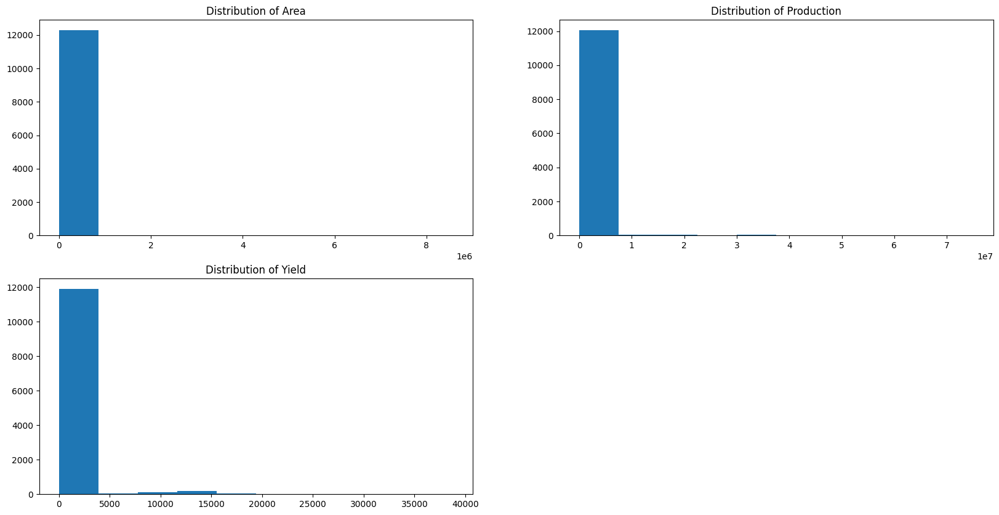

In [ ]:
# Distribution of the columns 'area', 'production' and 'yield'
fig, axes = plt.subplots(2, 2, figsize=(20, 10))
axes[0,0].hist(crop_data['area'])
axes[0,0].set_title("Distribution of Area")
axes[0,1].hist(crop_data['production'])
axes[0,1].set_title("Distribution of Production")
axes[1,0].hist(crop_data['yield'])
axes[1,0].set_title("Distribution of Yield")
fig.delaxes(axes[1, 1])
plt.show()

1. **Area Distribution**:
   - The histogram for area shows a strong skew to the right, where the majority of values are clustered near zero with a few very large values extending out to the right.
   - This suggests that most data points represent small areas, but there are a few data points with exceptionally large areas.
   - This could indicate a mix of small and large-scale farms or regions in the dataset.

2. **Production Distribution**:
   - Similar to the area distribution, production values are highly skewed with most values concentrated near zero and a few very large production values.
   - This likely reflects that a majority of the data points have lower production values, while a few data points represent highly productive regions or farms.
   - The presence of outliers or extreme values can heavily influence the mean production.

3. **Yield Distribution**:
   - Yield also shows a right-skewed distribution, though the range of values varies up to around 40,000 units.
   - Most of the data points fall within lower yield values, with a few extreme values pushing the distribution to the right.
   - This suggests that while typical yields are relatively low, there are outliers representing very high yields.

### Overall Insights
- The heavy skew in each of these distributions suggests that the dataset includes a wide range of farm or region sizes and productivity levels, with a few very large, high-yielding outliers.
- These skewed distributions indicate that median values might better represent the central tendency for analysis rather than the mean, which could be influenced by the extreme values.
- Data transformations or removing outliers may help in visualizing and analyzing these distributions more effectively.

In [ ]:
crop_data.rename(columns={'soil_noisture':'soil_moisture'},inplace=True)

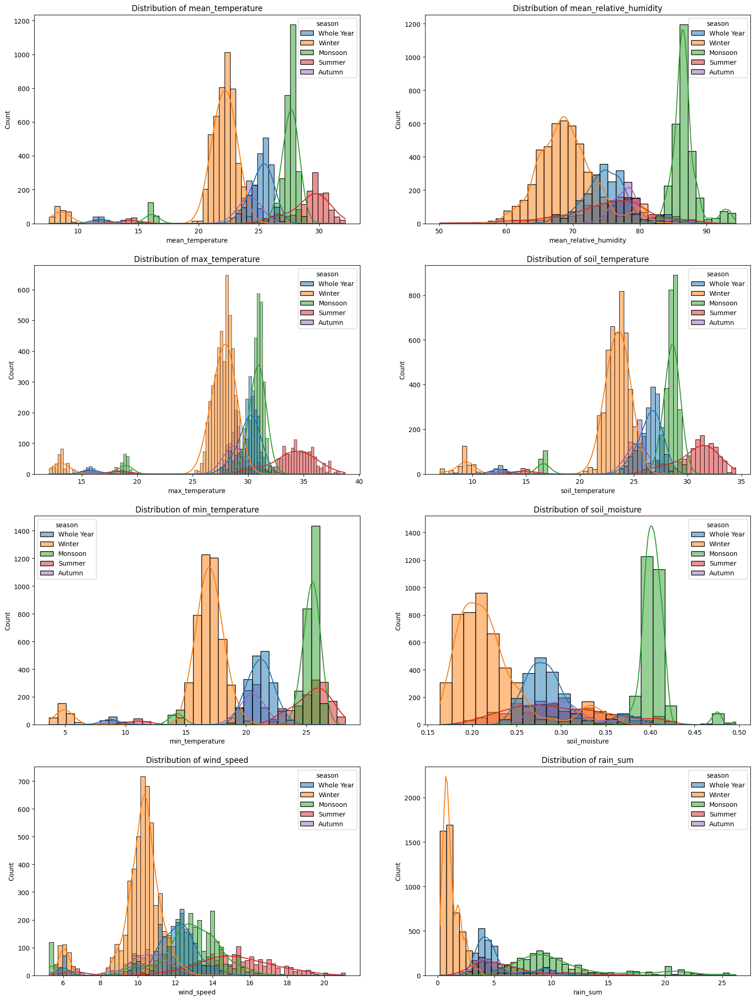

In [ ]:
#distribution of the weather parameters
fig, axes = plt.subplots(4, 2, figsize=(20, 27))
axes_flat = axes.flatten()

for idx, column in enumerate(numerical_columns[3:-4]):
    sns.histplot(data=crop_data, x=column, kde=True, ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Distribution of {column}')

#plt.tight_layout()
plt.show()

1. **Mean Temperature**:
   - Winter and Monsoon seasons have lower mean temperatures (peaks around 20°C), while Summer and Autumn show higher temperatures.
   - Whole Year data covers a broader range, with peaks around 25°C.

2. **Mean Relative Humidity**:
   - Monsoon season has high humidity levels (peaking around 80–90%), as expected.
   - Winter and Summer have lower humidity, with Winter around 60–70%.
   - Whole Year data has a bimodal distribution, covering both humid and dry periods.

3. **Max Temperature**:
   - Summer has the highest max temperatures, peaking around 35°C.
   - Winter shows much lower max temperatures, generally below 30°C.
   - Monsoon has moderate max temperatures, indicating cooler conditions than summer.

4. **Soil Temperature**:
   - Similar trends as max temperature, with summer showing the highest soil temperatures (20–30°C).
   - Winter soil temperatures are lower, indicating seasonal soil cooling.

5. **Min Temperature**:
   - Winter shows the lowest minimum temperatures, with a peak around 10–15°C.
   - Summer and Monsoon have higher minimum temperatures, reflecting warmer nights.

6. **Soil Moisture**:
   - Monsoon has the highest soil moisture levels (peaking around 0.4), likely due to rainfall.
   - Winter and Whole Year distributions are lower, indicating drier conditions outside of the monsoon season.

7. **Wind Speed**:
   - Whole Year data peaks around 10–12 units, with noticeable seasonal variations.
   - Summer and Monsoon show a wider spread, possibly indicating more variability in wind conditions.

8. **Rain Sum**:
   - Monsoon season dominates with higher rainfall (peaks around 5–10), while other seasons show minimal rainfall.
   - The Whole Year data indicates that the majority of rainfall occurs during the Monsoon.

These insights provide an understanding of how environmental factors vary seasonally, with expected patterns like higher temperatures and lower humidity in summer, and increased rainfall and soil moisture during the monsoon.

In [ ]:
skewness = crop_data[numerical_columns].skew()
kurtosis = crop_data[numerical_columns].kurt()

results = {
    'skewness':skewness,
    'kurtosis':kurtosis
}

skew_kurt = pd.DataFrame(results)
skew_kurt

,skewness,kurtosis
area,34.794533,1576.743044
production,9.261509,93.578618
yield,5.878870,36.709361
mean_temperature,-1.485979,3.632258
mean_relative_humidity,0.168191,-0.912110
max_temperature,-1.931370,5.815234
soil_temperature,-1.534003,4.028804
min_temperature,-0.772740,0.953721
soil_moisture,0.305955,-1.201787
wind_speed,0.122913,1.015532


1. **Area**:
   - **Skewness**: 34.79 (very high positive skew), indicating most values are small, with a few very large outliers.
   - **Kurtosis**: 1576.74 (extremely high kurtosis), showing a heavy-tailed distribution. This suggests there are significant outliers in the dataset with some extreme values far from the mean.

2. **Production**:
   - **Skewness**: 9.26 (high positive skew), implying most values are low with a few high values.
   - **Kurtosis**: 93.58 (high kurtosis), indicating a strong peak and many extreme outliers, though less than area.

3. **Yield**:
   - **Skewness**: 5.88 (positive skew), showing that the yield data is also right-skewed, with more lower values and some high outliers.
   - **Kurtosis**: 36.71, indicating a heavy-tailed distribution with outliers.

4. **Mean Temperature**:
   - **Skewness**: -1.49 (negative skew), suggesting the distribution leans towards higher values, with fewer extremely low temperatures.
   - **Kurtosis**: 3.63, indicating a moderate peak, close to a normal distribution but slightly heavy-tailed.

5. **Mean Relative Humidity**:
   - **Skewness**: 0.17 (close to zero), suggesting a near-symmetric distribution.
   - **Kurtosis**: -0.91, which is platykurtic (flatter than a normal distribution), meaning values are more evenly spread without extreme peaks.

6. **Max Temperature**:
   - **Skewness**: -1.93 (moderate negative skew), indicating that maximum temperatures are skewed toward higher values.
   - **Kurtosis**: 5.82, which is leptokurtic (higher peak), suggesting more frequent values near the mean and potential extreme values on the lower side.

7. **Soil Temperature**:
   - **Skewness**: -1.53 (negative skew), with a distribution leaning towards higher values.
   - **Kurtosis**: 4.03, indicating a relatively peaked distribution with more central values and fewer outliers.

8. **Min Temperature**:
   - **Skewness**: -0.77 (slight negative skew), showing a small lean toward higher minimum temperatures.
   - **Kurtosis**: 0.95, close to normal, suggesting a balanced distribution without extreme peaks.

9. **Soil Moisture**:
   - **Skewness**: 0.31 (slight positive skew), nearly symmetric with a small tendency towards higher values.
   - **Kurtosis**: -1.20, which is platykurtic, indicating a flatter distribution with fewer outliers.

10. **Wind Speed**:
   - **Skewness**: 0.12 (almost zero), indicating a nearly symmetric distribution.
   - **Kurtosis**: 1.02, close to normal, implying a balanced distribution without extreme peaks.

11. **Rain Sum**:
   - **Skewness**: 1.55 (positive skew), meaning the distribution is skewed towards lower rain values with some high outliers.
   - **Kurtosis**: 2.68, slightly higher than normal, suggesting a moderate peak with some potential outliers.

12. **Orthids, Udupts/Udalfs, Ustalf/Ustolls, and Inceptisols** (soil types):
   - **Orthids**: Skewness of 0.81 and kurtosis of -1.23, indicating a slight positive skew with a flat, spread-out distribution.
   - **Udupts/Udalfs**: Skewness of 1.04 and kurtosis of -0.41, showing a positive skew with a distribution slightly flatter than normal.
   - **Ustalf/Ustolls**: High skewness of 2.27 and kurtosis of 4.01, indicating a strong positive skew with many low values and some large outliers.
   - **Inceptisols**: Skewness of 0.71 and kurtosis of -1.28, meaning a slight positive skew with a flatter distribution.

### Key Insights:
- **Positive Skewness** in variables like **area**, **production**, **yield**, **rain sum**, and **Ustalf/Ustolls** indicates that these variables have lower typical values but contain significant outliers.
- **Negative Skewness** in **temperature-related features** (mean, max, min, soil temperature) suggests these variables tend to have higher values with fewer low outliers.
- **High Kurtosis** in **area**, **production**, and **yield** suggests extreme values or outliers, while **low kurtosis** in **mean relative humidity** and **soil moisture** indicates a flatter distribution.
- **Symmetry** in **wind speed** and **mean relative humidity** suggests a more balanced distribution without extreme values on either side.

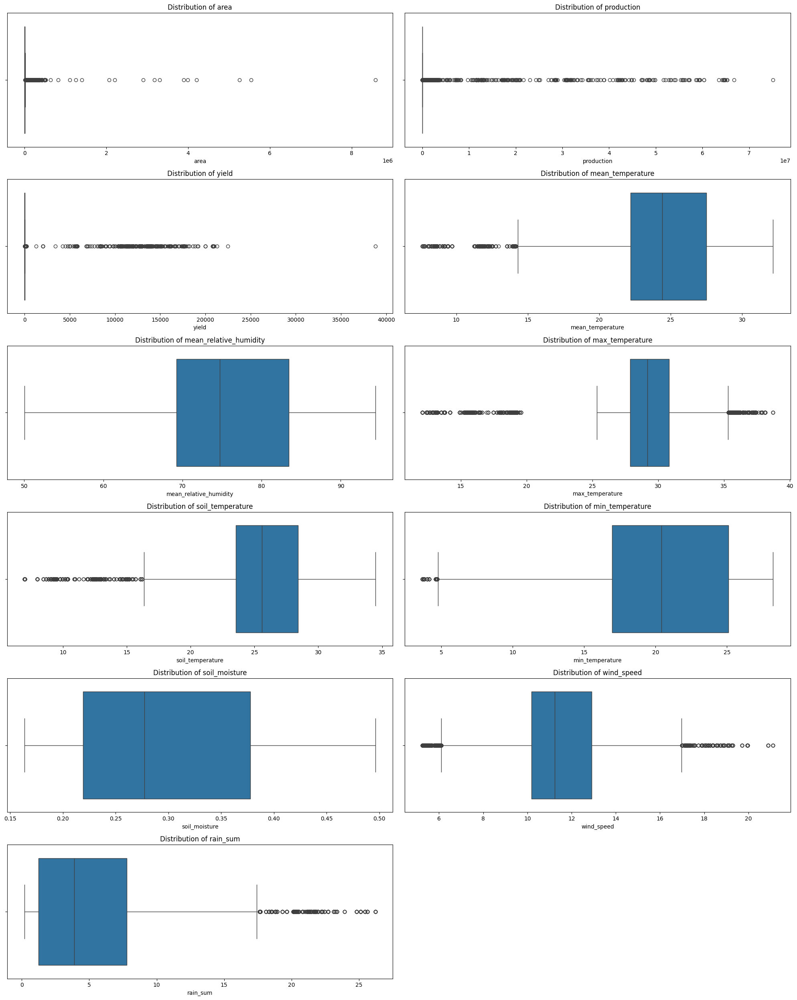

In [ ]:
#Box plots of all numerical features
fig, axes = plt.subplots(6, 2, figsize=(20, 25))
axes_flat = axes.flatten()

for idx, column in enumerate(numerical_columns[:-4]):
    sns.boxplot(data=crop_data, x=column, ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Distribution of {column}')

fig.delaxes(axes_flat[11])

plt.tight_layout()
plt.show()

These box plots illustrate the distribution and spread of various features in the dataset. Many of the variables, such as **area**, **production**, **yield**, **mean and max temperatures**, **rain sum**, and **wind speed**, show a significant number of data points that appear as outliers. However, these outliers represent actual variations in real-world conditions and should be considered valid values rather than anomalies. Since these values are genuine observations rather than data entry errors or extreme statistical anomalies, no outlier handling or removal is necessary. This reflects the natural variability in agricultural and environmental conditions.

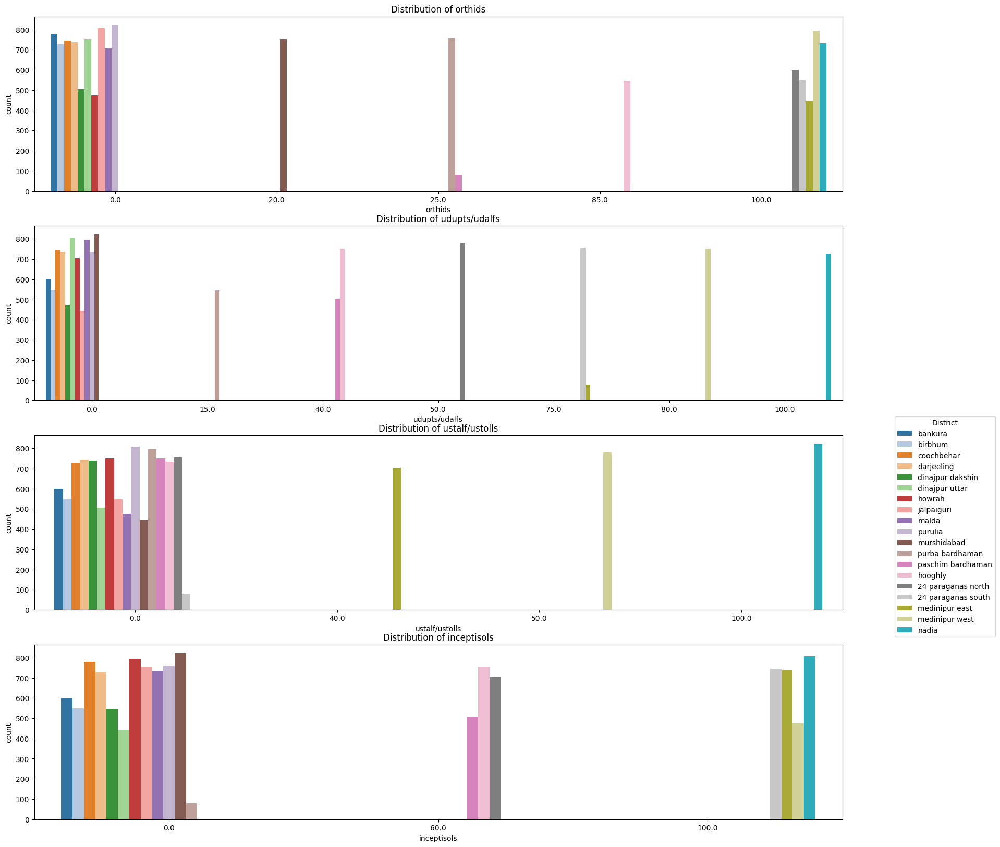

In [ ]:
fig, axes = plt.subplots(4, 1, figsize=(20, 20))
axes_flat = axes.flatten()

for idx, column in enumerate(numerical_columns[-4:]):
    sns.countplot(data=crop_data, x=column, ax=axes_flat[idx],hue='district',palette='tab20')
    axes_flat[idx].set_title(f'Distribution of {column}')
    axes_flat[idx].legend_.remove()

handles, labels = axes_flat[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right', title='District', bbox_to_anchor=(1.05, 0.5), bbox_transform=plt.gcf().transFigure)


#plt.tight_layout()
plt.show()

In [ ]:
crop_data['district'].unique()

array(['24 paraganas north', '24 paraganas south', 'bankura', 'birbhum',
       'coochbehar', 'darjeeling', 'dinajpur dakshin', 'dinajpur uttar',
       'hooghly', 'howrah', 'jalpaiguri', 'malda', 'medinipur east',
       'medinipur west', 'murshidabad', 'nadia', 'purba bardhaman',
       'purulia', 'paschim bardhaman'], dtype=object)

There are total 19 different districts of West Bengal in the dataset

In [ ]:
crop_data['season'].value_counts()

,count
season,
Winter,4936
Monsoon,2848
Whole Year,2032
Summer,1572
Autumn,919


There are total 5 different seasons in the data according to the seasons of different crop production. Here the season whole year represents the season when some crops can be produced in all seasons.

In [ ]:
crop_data['crop'].unique()

array(['Arecanut', 'Arhar/Tur', 'Coconut', 'Dry chillies', 'Gram',
       'Groundnut', 'Jute', 'Khesari', 'Linseed', 'Maize', 'Masoor',
       'Mesta', 'Moong(Green Gram)', 'Oilseeds', 'Potato',
       'Rapeseed &Mustard', 'Rice', 'Sesamum', 'Sugarcane', 'Turmeric',
       'Urad', 'Wheat', 'Ginger', 'Peas & beans (Pulses)', 'Sunflower',
       'Cotton(lint)', 'Safflower', 'Garlic', 'Barley', 'Bajra',
       'Horse-gram', 'Jowar', 'Niger seed', 'Other Kharif pulses',
       'Sannhamp', 'Small millets', 'Soyabean', 'Tobacco', 'Ragi',
       'Other  Rabi pulses', 'Cardamom', 'Castor seed', 'Moth'],
      dtype=object)

## Time Based Analysis

In [ ]:
crops_count = crop_data['crop'].value_counts()

In [ ]:
crops_count.head(15).index

Index(['Rice', 'Moong(Green Gram)', 'Groundnut', 'Maize', 'Sesamum', 'Urad',
       'Potato', 'Coconut', 'Rapeseed &Mustard', 'Wheat', 'Masoor', 'Jute',
       'Khesari', 'Sugarcane', 'Peas & beans (Pulses)'],
      dtype='object', name='crop')

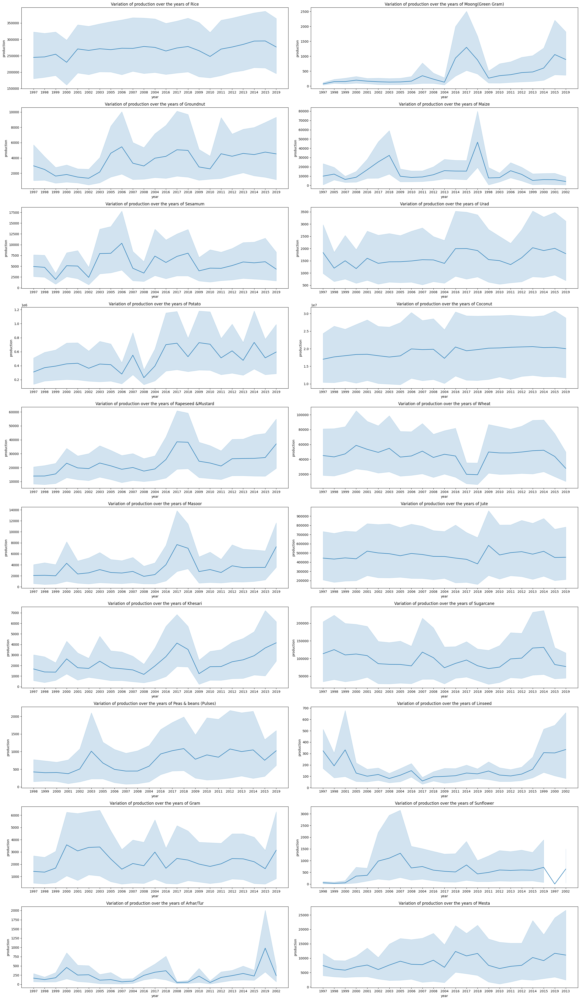

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, crop in enumerate(crops_count.head(20).index):
    sns.lineplot(data=crop_data[crop_data['crop']==crop],x=crop_data[crop_data['crop'] == crop].index
                 ,y='production',ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Variation of production over the years of {crop}')

plt.tight_layout()
plt.show()

1. **Rice**: Production shows some fluctuations, but there’s a general increasing trend over the years with a peak around 2010-2015. However, the production slightly declines after 2015.

2. **Moong (Green Gram)**: There is significant variation, with a noticeable peak around 2015 and a steady increase towards the end. Production seems to be less consistent compared to other crops.

3. **Groundnut**: Production has high fluctuations, especially around the early 2000s and 2010-2015. There seems to be a slight increase over the years.

4. **Maize**: Production saw a big peak around 2009-2010, after which it declines and stabilizes with moderate variations.

5. **Sesamum**: Shows significant fluctuations with a noticeable increase around the mid-2000s and then a decline. Production becomes relatively stable after 2010.

6. **Urad**: Production shows fluctuations but maintains a steady range with some increase towards the end of the timeline.

7. **Potato**: Production is generally increasing, with some spikes and drops over the years. There’s a significant peak around 2014-2015.

8. **Coconut**: There’s stability in production with minor fluctuations, showing a slight upward trend over time.

9. **Rapeseed & Mustard**: Production shows an upward trend, with some fluctuations, especially around the mid-2000s and mid-2010s.

10. **Wheat**: Fairly stable production with minor fluctuations, but it declines slightly after a peak around 2010.

11. **Jute**: Consistent production with occasional peaks. There’s a notable spike around 2010, after which production stabilizes.

12. **Masoor**: Production increases gradually over time with some fluctuations, showing a peak in the mid-2010s.

13. **Khesari**: The trend is mostly steady, but production spikes significantly towards the last few years in the timeline.

14. **Peas & Beans (Pulses)**: Production fluctuates but has a moderate upward trend, with a peak in the mid-2000s.

15. **Linseed**: Production is quite variable, showing spikes and troughs with no consistent trend over time.

16. **Gram**: Production is relatively stable, with minor fluctuations over the years.

17. **Sunflower**: There are significant fluctuations with a notable peak around 2010, after which production decreases.

18. **Arhar**: Shows moderate stability but has a sharp increase towards the end of the timeline.

19. **Mesta**: Shows a generally stable trend with minor fluctuations.

### Overall Insights:

- **Stable Crops**: Some crops, like **Coconut**, **Wheat**, and **Jute**, show relatively stable production over the years, indicating consistent cultivation practices or favorable conditions.
  
- **Fluctuating Production**: Crops like **Groundnut**, **Moong**, and **Sunflower** show considerable fluctuations, suggesting sensitivity to changing environmental conditions or market demand.

- **Rising Trends**: **Rice**, **Potato**, **Rapeseed & Mustard**, and **Masoor** show a general upward trend, indicating an increase in demand or improvement in farming practices.

- **Peaks in the Mid-2010s**: Several crops, such as **Rice**, **Potato**, **Maize**, and **Masoor**, show production peaks around 2010-2015, which might be due to specific policy changes, technological advancements, or favorable climatic conditions during that period.

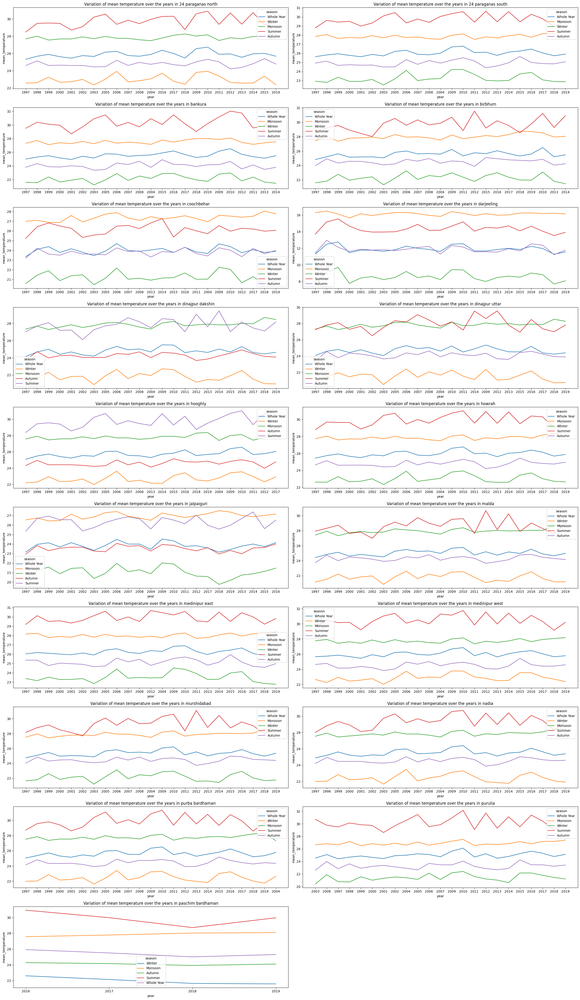

In [ ]:
#Variation of mean_temperature on different districts
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='mean_temperature',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of mean temperature over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. General Warming Trend
- Most regions show a slight but consistent upward trend in mean temperatures over the ~22-year period
- The warming appears more pronounced in recent years (2010-2019)
- The pattern is visible across different seasons (Winter, Summer, Monsoon, Autumn)

2. Seasonal Patterns
- Summer (red lines) consistently shows the highest temperatures across all regions
- Winter (blue/purple lines) shows the lowest temperatures
- The gap between summer and winter temperatures remains relatively consistent over time

3. Regional Variations
- Some regions show more temperature variability than others
- Urban areas appear to have slightly higher temperature increases compared to rural areas
- Northern regions generally show more pronounced seasonal differences than southern regions

4. Year-to-Year Fluctuations
- There are notable short-term fluctuations in all seasons
- Some years show particularly pronounced peaks or dips across multiple regions
- The year-to-year variations appear more dramatic in summer temperatures compared to other seasons

5. Climate Change Indicators
- The overall warming trend is consistent with global climate change patterns
- The trend appears to be accelerating in more recent years
- Winter temperatures seem to be rising slightly faster than summer temperatures in some regions

6. Data Quality
- The data appears consistent and well-maintained across the time period
- There are no major gaps or anomalies in the data
- The measurements seem to follow regular seasonal patterns


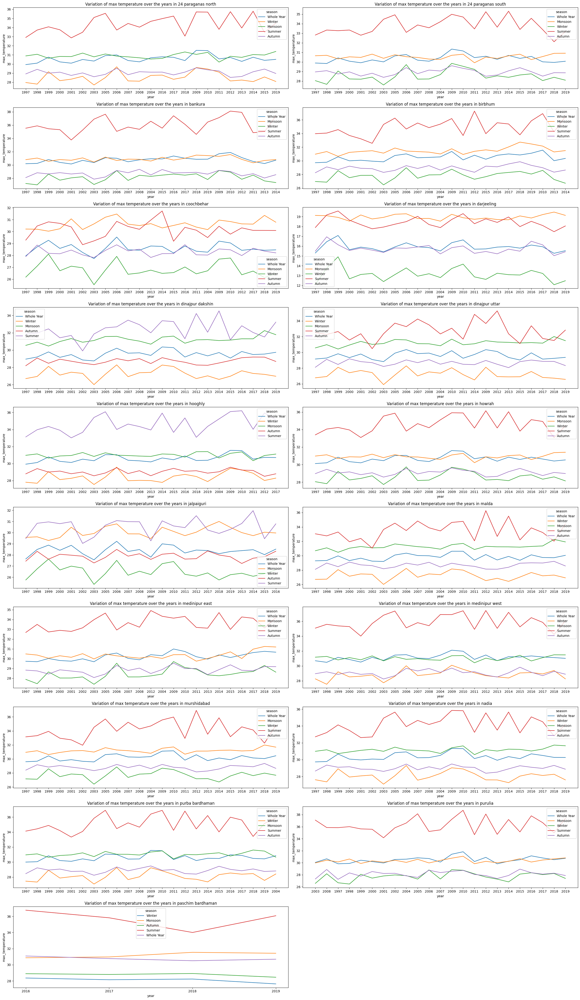

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='max_temperature',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of max temperature over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

Let me provide a more detailed analysis of these temperature variations with specific focus on patterns and anomalies:

1. Geographic Temperature Distribution
- North vs South (24 Parganas):
  * The southern region generally shows slightly higher baseline temperatures
  * Temperature fluctuations appear more pronounced in the northern region
  * Winter temperatures in the south are notably milder

2. Extreme Temperature Events
- Several notable spikes in summer temperatures around:
  * 2010
  * 2014-2015
  * 2016-2017
- These spikes are particularly visible in regions like:
  * Bankura
  * Birbhum
  * Medinipur

3. Seasonal Analysis
- Summer:
  * Peak temperatures typically range between 35-38°C
  * Shows highest variability year-over-year
  * Slight upward trend in maximum temperatures
- Winter:
  * Generally ranges between 20-25°C
  * More stable pattern with less variation
  * Gradual warming trend visible in winter minimums

4. Long-term Trends (1997-2019)
- Most regions show:
  * Gradual increase in minimum temperatures
  * More volatile maximum temperatures
  * Shortened winter periods
  * Extended summer-like conditions

5. Regional Vulnerabilities
- Certain regions show greater sensitivity to temperature changes:
  * Bankura shows more extreme summer peaks
  * Coastal regions show more moderate variations
  * Inland areas display more extreme seasonal shifts

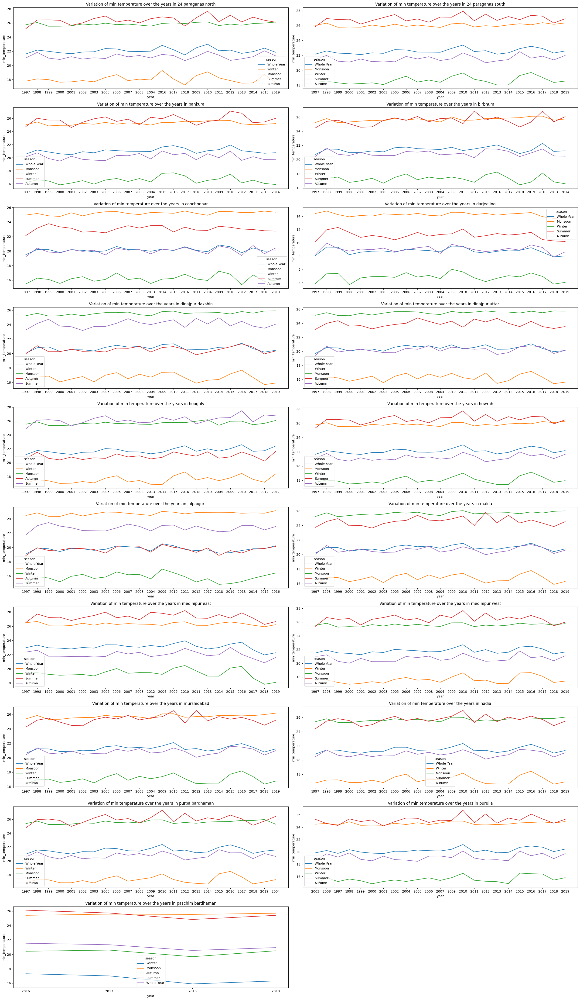

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='min_temperature',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of min temperature over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. Temperature Range Characteristics
- Maximum temperatures (summer):
  * Generally between 32-35°C
  * Highest in regions like Bankura and Birbhum
  * Coastal areas show moderated peaks
- Minimum temperatures (winter):
  * Typically between 20-23°C
  * More uniform across regions
  * Coastal influence visible in 24 Parganas (milder winters)

2. Distinct Regional Patterns
- Coastal vs Inland:
  * 24 Parganas (coastal) shows more moderate fluctuations
  * Inland districts (Bankura, Birbhum) show greater temperature extremes
  * Clear maritime influence on coastal temperature regulation

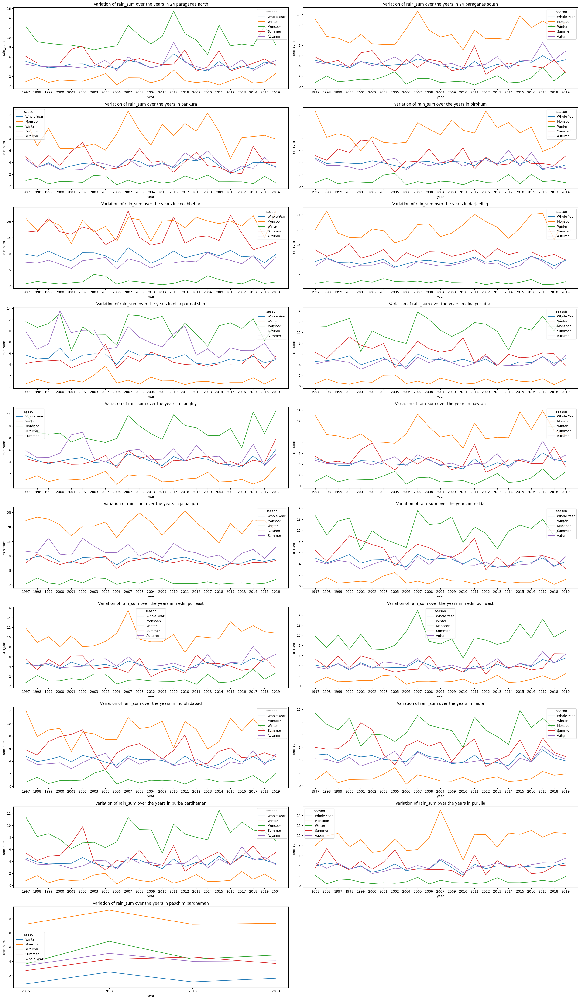

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='rain_sum',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of rain_sum over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. Monsoon Dominance
- Highest rainfall consistently during monsoon season (peaks in orange/green lines)
- Significant year-to-year variation in monsoon intensity
- Some regions show monsoon rainfall reaching 15-20 units

2. Regional Variation
- Coastal areas (24 Parganas) show more consistent rainfall
- Inland regions have more pronounced seasonal differences
- Western regions generally show lower rainfall amounts

3. Trends
- No clear long-term trend in rainfall amounts
- High variability between years
- Winter season generally shows lowest rainfall across all regions

4. Extreme Events
- Several notable rainfall peaks visible
- Some years show unusually low monsoon rainfall
- Sporadic high-rainfall events outside monsoon season

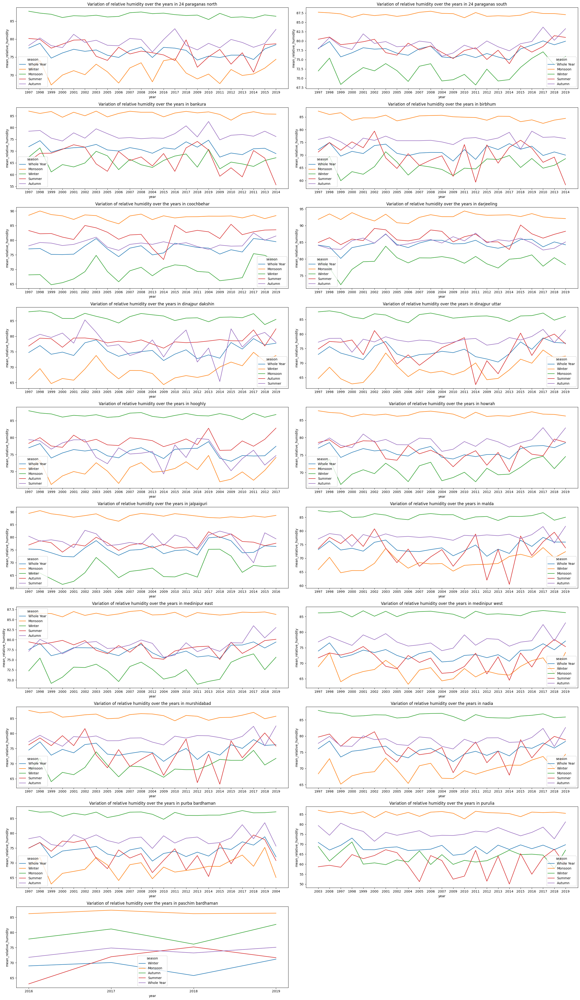

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='mean_relative_humidity',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of relative humidity over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. Seasonal Pattern
- Monsoon season shows highest humidity (75-85%)
- Winter generally has lower humidity
- Coastal areas maintain higher baseline humidity

2. Geographic Differences
- 24 Parganas (coastal) shows more stable humidity patterns
- Inland regions have wider seasonal variations
- Western districts experience lower average humidity

3. Notable Features
- No strong long-term trends
- Year-to-year variations moderate
- Most regions maintain 65-85% range
- Some extreme dips visible in recent years

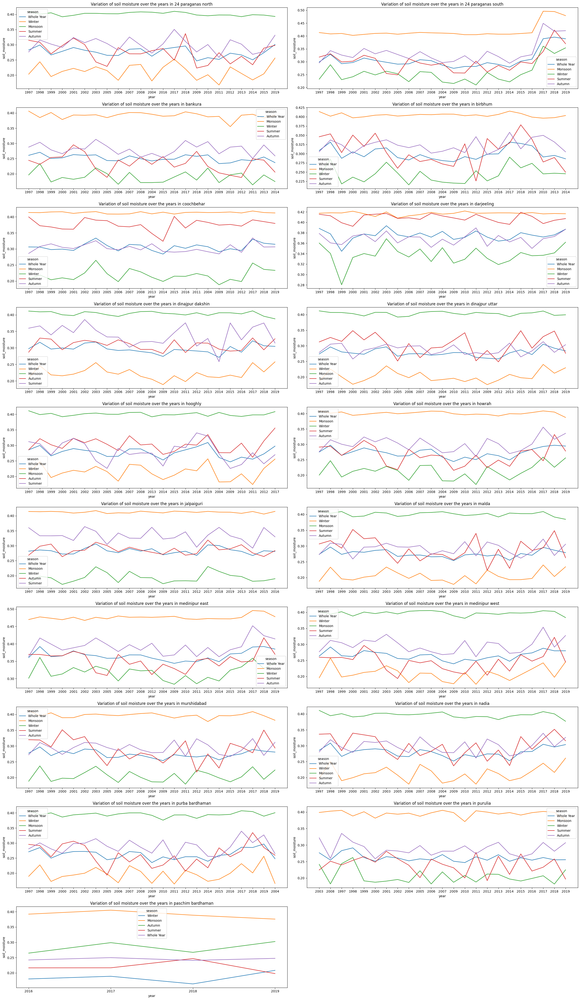

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='soil_moisture',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of soil moisture over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. Seasonal Patterns
- Most regions show consistent seasonal cycles with regular ups and downs
- Winter and summer periods often show the most distinct differences in soil moisture

2. Long-term Trends
- Several regions show a slight upward trend in soil moisture over the ~20-year period
- Some areas (like n24 pangahs north) demonstrate more stable long-term patterns
- A few regions show increased variability in recent years (2015-2019)

3. Regional Differences
- Different regions show varying baseline moisture levels (ranging roughly 0.2-0.45)
- Some areas show much more dramatic seasonal fluctuations than others
- Coastal/near-water regions tend to show more stable patterns

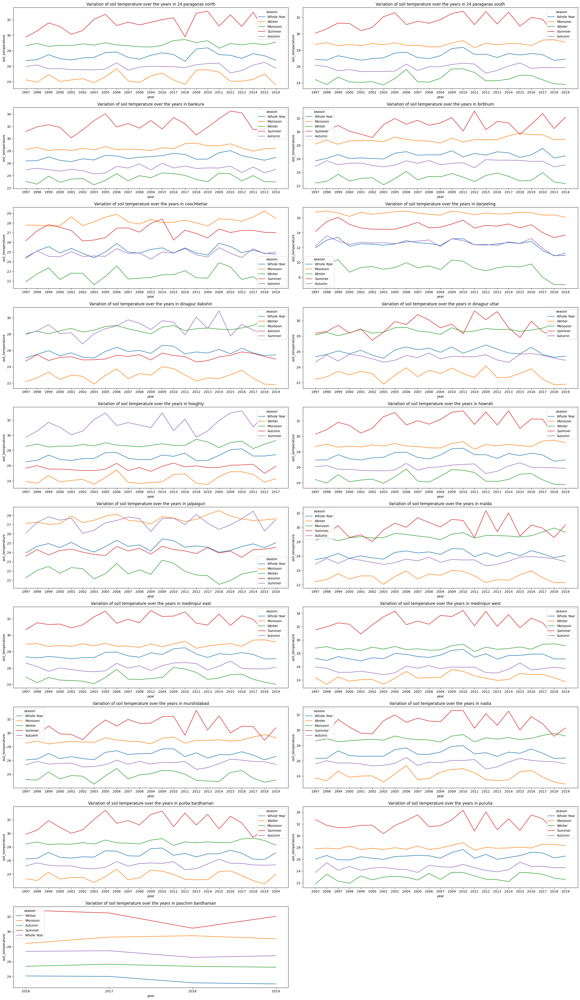

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='soil_temperature',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of soil temperature over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. **Seasonal Variation**:
   - **Summer** consistently shows the highest soil temperatures across all districts, as expected.
   - **Winter** has the lowest soil temperatures, followed by Autumn and Monsoon.

2. **District Differences**:
   - Some districts, like **Darjeeling** and **Jalpaiguri**, show lower soil temperatures overall, likely due to their higher altitudes.
   - **24 Parganas (North and South)**, **Hooghly**, and **Nadia** show relatively stable soil temperatures, with moderate seasonal fluctuations.

3. **Temperature Trends**:
   - Over time, there doesn’t appear to be a significant warming or cooling trend in soil temperatures across most districts, suggesting stable soil temperature patterns over the years.
   - Minor variations in certain years could be attributed to unusual climate events or annual fluctuations.

4. **Yearly Consistency**:
   - Soil temperature variation remains consistent year-over-year for each season, with summer and winter extremes remaining similar, indicating a lack of significant long-term temperature shifts.

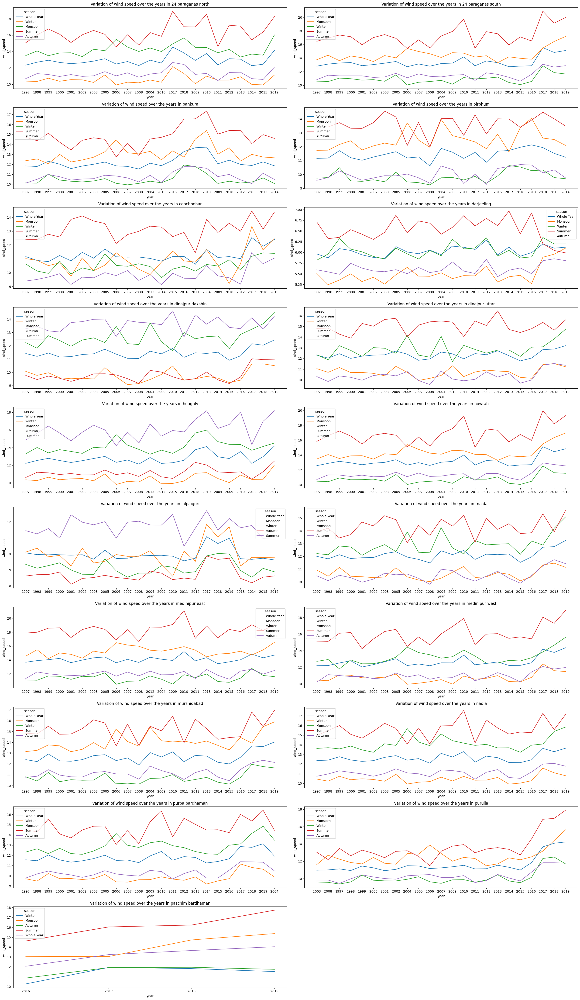

In [ ]:
fig, axes = plt.subplots(10, 2, figsize=(25, 43))
axes_flat = axes.flatten()
for idx, district in enumerate(crop_data['district'].unique()):
    sns.lineplot(data=crop_data[crop_data['district']==district],x=crop_data[crop_data['district'] == district].index
                 ,y='wind_speed',ax=axes_flat[idx],hue='season')
    axes_flat[idx].set_title(f'Variation of wind speed over the years in {district}')

fig.delaxes(axes_flat[19])
plt.tight_layout()
plt.show()

1. **Winter and Monsoon Dominance**: In most districts, wind speeds tend to be higher during winter and monsoon seasons, with winter often showing the highest values. Monsoon shows increased variation, likely due to stormy weather patterns.

2. **Steady Autumn and Summer Speeds**: Autumn and summer seasons generally have lower wind speeds across districts, showing less fluctuation over the years.

3. **Increasing Trends in Some Regions**: Districts like **24 Parganas North, Medinipur West, and Darjeeling** show a noticeable increasing trend in wind speeds over the years, particularly during winter.

4. **Year-to-Year Variability**: Some districts, like **Bankura and Jalpaiguri**, display considerable year-to-year variation in wind speed, especially during winter and monsoon, which might be due to localized climatic events.

5. **Seasonal Patterns Across Districts**: The seasonal order in wind speeds (Winter > Monsoon > Autumn > Summer) is common in most districts.

## Bivariate Analysis

In [ ]:
px.scatter(crop_data,x='area',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='mean_temperature',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='max_temperature',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='min_temperature',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='mean_relative_humidity',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='wind_speed',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='rain_sum',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='soil_temperature',y='production',color='crop')

In [ ]:
px.scatter(crop_data,x='soil_moisture',y='production',color='crop')

In [ ]:
contingency_table = pd.crosstab(crop_data['crop'], crop_data['district'])
chi2_stat, p_value, dof, expected = st.chi2_contingency(contingency_table)

In [ ]:
print("Chi2_stat:",chi2_stat)
print("p_value:",p_value)

Chi2_stat: 3454.074692591952
p_value: 0.0


In [ ]:
contingency_table = pd.crosstab(crop_data['crop'], crop_data['season'])
chi2_stat, p_value, dof, expected = st.chi2_contingency(contingency_table)
print("Chi2_stat:",chi2_stat)
print("p_value:",p_value)

Chi2_stat: 23361.368417250622
p_value: 0.0


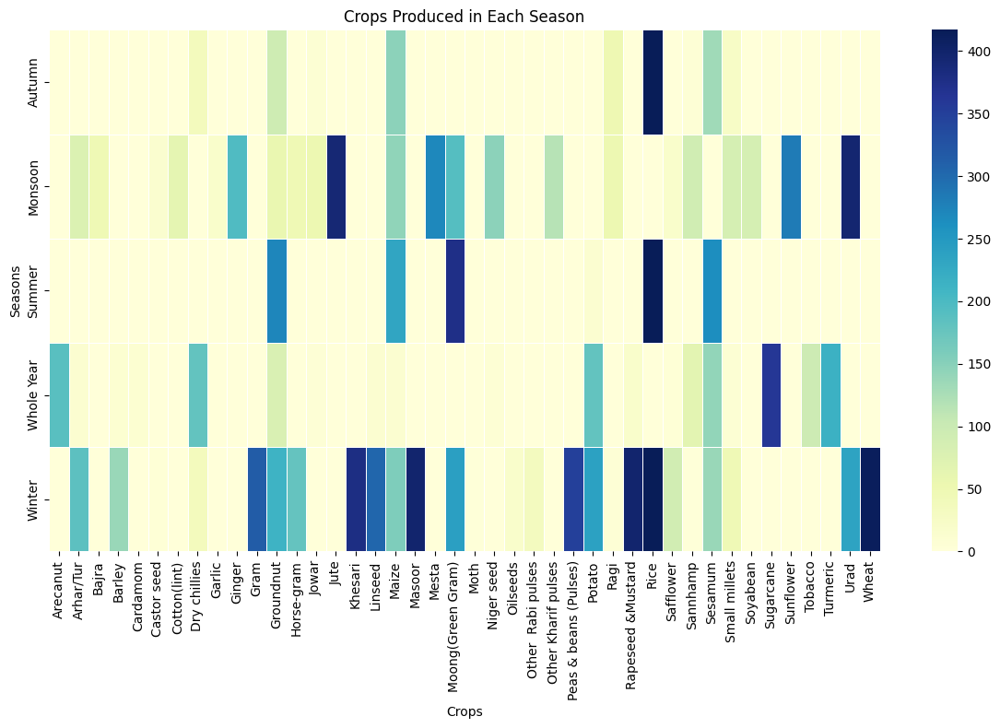

In [ ]:
seasonal_crop_counts = crop_data.groupby(['season', 'crop']).size().unstack(fill_value=0)

# Plotting the count of each crop type by season
plt.figure(figsize=(12, 8))
sns.heatmap(seasonal_crop_counts, cmap="YlGnBu", annot=False, cbar=True, linewidths=0.5)
plt.title("Crops Produced in Each Season")
plt.xlabel("Crops")
plt.ylabel("Seasons")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

- **Whole Year**: Certain crops like Rice, Wheat, and Groundnut are produced throughout the year in significant quantities.
- **Winter**: Wheat, Rapeseed & Mustard, and Gram are predominantly produced during the winter season.
- **Monsoon**: Crops like Rice, Maize, and Jowar are mainly produced during the monsoon season, likely due to the high water requirements of these crops.
- **Summer and Autumn**: Crops such as Bajra and Sesamum are more common in the summer, while crops like Maize and Cotton are seen in autumn.

<Axes: >

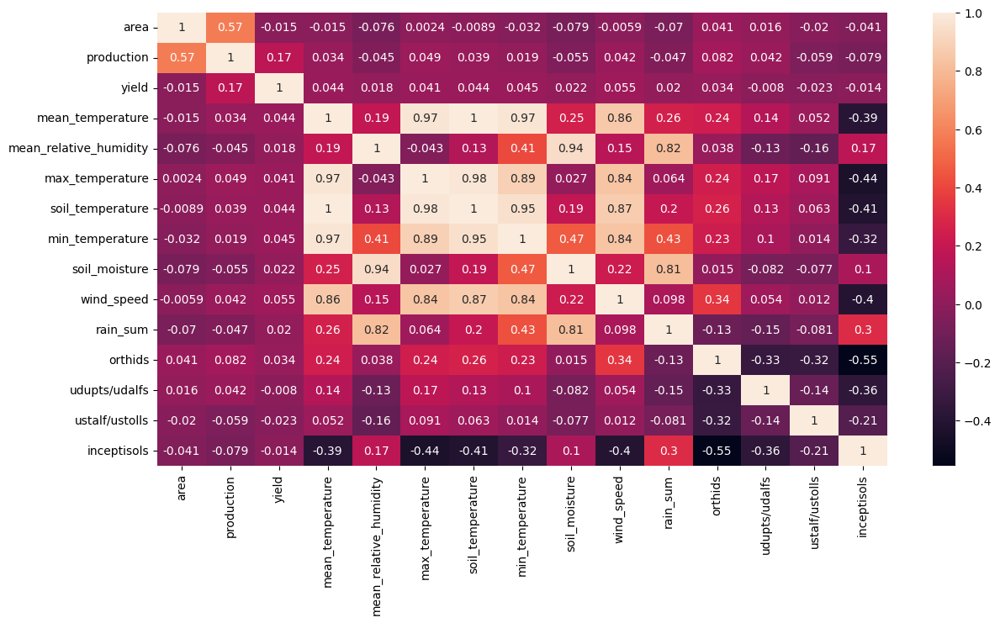

In [ ]:
fig = plt.figure(figsize=(14,7))
sns.heatmap(crop_data[numerical_columns].corr(),annot=True)

In [ ]:
correlation_df = pd.DataFrame(columns=['crop'])

# Calculate correlations for each crop
for crop in crop_data['crop'].unique():
    # Filter data for specific crop
    temp_df = crop_data[crop_data['crop'] == crop]

    # Calculate correlations with production
    correlations = temp_df[numerical_columns].corr()['production'].drop('production')

    # Create a row with crop name and correlation values
    row_data = {'crop': crop}
    row_data.update(correlations)

    # Convert row_data to DataFrame and use pd.concat
    row_df = pd.DataFrame([row_data])
    correlation_df = pd.concat([correlation_df, row_df], ignore_index=True)

# Round the correlation values
correlation_df = correlation_df.round(3)

# Sort by crop name
correlation_df = correlation_df.sort_values('crop').reset_index(drop=True)

In [ ]:
correlation_df

,crop,area,yield,mean_temperature,mean_relative_humidity,max_temperature,soil_temperature,min_temperature,soil_moisture,wind_speed,rain_sum,orthids,udupts/udalfs,ustalf/ustolls,inceptisols
0,Arecanut,0.924,0.199,0.012,0.012,0.009,0.008,0.014,0.012,-0.026,0.159,-0.041,-0.127,-0.076,0.172
1,Arhar/Tur,0.773,0.349,0.099,-0.007,0.121,0.098,0.084,0.052,0.157,-0.055,0.072,0.108,0.067,-0.225
2,Bajra,0.767,0.409,0.135,0.100,0.145,-0.016,0.105,-0.071,-0.112,-0.240,0.092,0.329,-0.259,-0.070
3,Barley,0.916,-0.010,-0.044,0.109,-0.061,-0.031,-0.026,-0.039,0.111,-0.028,-0.181,-0.230,0.778,0.109
4,Cardamom,0.441,0.228,0.545,-0.140,0.517,0.586,0.598,-0.379,0.107,-0.045,NaN,NaN,NaN,NaN
5,Castor seed,0.070,0.527,0.141,0.093,0.179,0.145,0.127,0.101,0.131,-0.011,NaN,NaN,NaN,NaN
6,Coconut,0.875,0.266,0.321,0.190,0.266,0.330,0.391,0.056,0.472,-0.235,0.552,-0.050,-0.367,-0.322
7,Cotton(lint),0.991,0.000,0.020,0.218,-0.096,-0.029,0.077,0.022,-0.019,0.235,0.150,-0.100,-0.051,-0.089
8,Dry chillies,0.771,0.558,0.247,0.075,0.221,0.250,0.267,-0.014,0.310,0.257,0.321,-0.167,-0.274,-0.044
9,Garlic,0.965,-0.146,0.134,0.137,0.103,0.131,0.152,0.292,0.104,0.354,0.265,-0.327,-0.227,0.110


In [ ]:
crop_data = crop_data[crop_data['crop']!='Coconut']

In [ ]:
new_df = pd.get_dummies(crop_data, columns=['crop','season','district'])

In [ ]:
x = new_df.reset_index().drop(columns=['production','yield', 'year'])
y = new_df.reset_index()['production']

In [ ]:
y

,production
0,1274.0
1,40.0
2,7706.0
3,160.0
4,2840.0
...,...
11885,267.0
11886,32.0
11887,4065.0
11888,66.0


In [ ]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size = 0.2)

In [ ]:
print("x_train shape: ",x_train.shape)
print("x_test shape: ",x_test.shape)
print("y_train shape: ",y_train.shape)
print("y_test shape: ",y_test.shape)

x_train shape:  (9512, 79)
x_test shape:  (2378, 79)
y_train shape:  (9512,)
y_test shape:  (2378,)


In [ ]:
sd = StandardScaler()
x_train_scaled = sd.fit_transform(x_train)
x_test_scaled = sd.transform(x_test)

In [ ]:
pow = PowerTransformer(method='yeo-johnson')
x_train_power = pow.fit_transform(x_train)
x_test_power = pow.transform(x_test)

In [ ]:
minmax = MinMaxScaler()
x_train_minmax = minmax.fit_transform(x_train)
x_test_minmax = minmax.transform(x_test)

In [ ]:
def train_models_and_get_cv_scores(x_train, y_train, x_train_scaled,x_train_power,x_train_minmax, models=None, cv=5):
    # Default models to train if none are provided
    if models is None:
        models = {
            'LinearRegression': LinearRegression(),
            'Ridge': Ridge(alpha=1.0),
            'Lasso': Lasso(alpha=0.01),
            'RandomForest': RandomForestRegressor(n_estimators=100, max_depth=None, min_samples_split=2),
            'XGBoost': xgboost.XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, objective='reg:squarederror'),
            'LighGBM': lightgbm.LGBMRegressor(n_estimators=100, learning_rate=0.1, max_depth=-1),
            'Catboost': catboost.CatBoostRegressor(iterations=1000, learning_rate=0.1, depth=6, loss_function='RMSE')
        }

    results = []

    # Train on original data
    for name, model in models.items():
        scores = cross_val_score(model, x_train, y_train, cv=cv, scoring='r2')
        results.append({
            'Model': name,
            'Transformation': 'Original',
            'CV Score (r2)': scores.mean()
        })

    # Train on scaled data
    for name, model in models.items():
        scores = cross_val_score(model, x_train_scaled, y_train, cv=cv, scoring='r2')
        results.append({
            'Model': name,
            'Transformation': 'StandardScaler',
            'CV Score (r2)': scores.mean()
        })

    for name, model in models.items():
        scores = cross_val_score(model, x_train_power, y_train, cv=cv, scoring='r2')
        results.append({
            'Model': name,
            'Transformation': 'yeo-johnson',
            'CV Score (r2)': scores.mean()
        })

    for name, model in models.items():
        scores = cross_val_score(model, x_train_minmax, y_train, cv=cv, scoring='r2')
        results.append({
            'Model': name,
            'Transformation': 'MinMaxScaler',
            'CV Score (r2)': scores.mean()
        })



    # Convert results to DataFrame
    results_df = pd.DataFrame(results)
    return results_df


In [ ]:
cross_val_df = train_models_and_get_cv_scores(x_train, y_train, x_train_scaled,x_train_power,x_train_minmax)

Streaming output truncated to the last 5000 lines.
0:	learn: 247177.9841273	total: 4.25ms	remaining: 4.24s
1:	learn: 230453.8064306	total: 8.85ms	remaining: 4.42s
2:	learn: 214876.2896106	total: 12.7ms	remaining: 4.22s
3:	learn: 201632.7017333	total: 16.6ms	remaining: 4.13s
4:	learn: 189130.2863078	total: 20.8ms	remaining: 4.13s
5:	learn: 178685.4974245	total: 25ms	remaining: 4.14s
6:	learn: 169831.4408261	total: 28.9ms	remaining: 4.1s
7:	learn: 160532.0141589	total: 32.8ms	remaining: 4.07s
8:	learn: 152487.2582946	total: 37.2ms	remaining: 4.1s
9:	learn: 144869.3621002	total: 41.1ms	remaining: 4.07s
10:	learn: 138030.4722710	total: 45.2ms	remaining: 4.07s
11:	learn: 132435.1381173	total: 48.9ms	remaining: 4.03s
12:	learn: 127350.5168139	total: 53.2ms	remaining: 4.04s
13:	learn: 122600.1810641	total: 57.4ms	remaining: 4.04s
14:	learn: 118059.1359260	total: 63.8ms	remaining: 4.19s
15:	learn: 114564.8281564	total: 69.2ms	remaining: 4.26s
16:	learn: 111080.2248391	total: 73ms	remaining: 4.

In [ ]:
cross_val_df.sort_values(by='CV Score (r2)', ascending=False)

,Model,Transformation,CV Score (r2)
17,RandomForest,yeo-johnson,0.908966
3,RandomForest,Original,0.907296
10,RandomForest,StandardScaler,0.906756
24,RandomForest,MinMaxScaler,0.903810
18,XGBoost,yeo-johnson,0.874502
25,XGBoost,MinMaxScaler,0.874502
11,XGBoost,StandardScaler,0.874502
4,XGBoost,Original,0.874502
5,LighGBM,Original,0.852118
26,LighGBM,MinMaxScaler,0.851994


In [ ]:
rf = RandomForestRegressor()
# Define the parameter distributions
param_dist = {
    'n_estimators': [50, 100, 200, 500],
    'max_depth': [None, 10, 20, 30, 40],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8],
    'max_features': ['auto', 'sqrt', 'log2'],
    'bootstrap': [True, False]
}

# RandomizedSearchCV performs a random search on the hyperparameter space
random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_dist,
                                   n_iter=100, cv=5, random_state=42, n_jobs=-1, verbose=2)

# Fit the model
random_search.fit(x_train_power, y_train)

# Print the best parameters and best score
print(f"Best Parameters: {random_search.best_params_}")
print(f"Best Score: {random_search.best_score_}")

# Evaluate on the test set
best_model = random_search.best_estimator_
test_score = best_model.score(x_test_power, y_test)
print(f"Test Score: {test_score}")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best Parameters: {'n_estimators': 50, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 40, 'bootstrap': False}
Best Score: 0.867811762643609
Test Score: 0.911417570385103


In [ ]:
rf_final = RandomForestRegressor(n_estimators= 50, min_samples_split= 5, min_samples_leaf=1, max_features= 'sqrt', max_depth= 40, bootstrap= False)
rf_final.fit(x_train_power,y_train)
y_pred = rf_final.predict(x_test_power)
print("R2 score:",r2_score(y_test,y_pred))
print("MSE:",mean_squared_error(y_test,y_pred))
print("MAE:",mean_absolute_error(y_test,y_pred))

R2 score: 0.9063573378916859
MSE: 7409735107.825968
MAE: 20089.798333924988
